In [1]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import zscore
import shutil

# Not important

In [13]:
missing_data = pd.read_csv('/Users/danielgarcia-barnett/Desktop/feb_5_cpCST_missing_data.csv').rename(columns={'Unnamed: 0':'participant'})[['participant', 'Flanker', 'proc_cpCST', 'IRT']]

In [21]:
missing_data_dict = {}
for col in missing_data:
    if 'part' not in col and 'Flanker' not in col:
        missing_data_dict[col] = missing_data[missing_data[col] == 1].participant.values

In [23]:
missing_data_dict

{'proc_cpCST': array(['M10909540', 'M10929065', 'M10952753', 'M10964357', 'M10970400'],
       dtype=object),
 'IRT': array(['M10902833', 'M10905521', 'M10909540', 'M10913260', 'M10917604',
        'M10929065', 'M10929927', 'M10943691', 'M10945575', 'M10950715',
        'M10952753', 'M10958986', 'M10963227', 'M10964357', 'M10966987',
        'M10970400', 'M10976322', 'M10992053'], dtype=object)}

In [29]:
raw_cpcst_data = '/Users/danielgarcia-barnett/Desktop/Coding/cpCST_data_analysis/IRT_extraction/test_data/feb_1_2025/raw_cpCST_data'

temp = {}
for file in os.listdir(raw_cpcst_data):
    if any(ptp for ptp in missing_data_dict['proc_cpCST'] if ptp in file):
        temp[file.split('_')[0].split('-')[1]] = os.path.join(raw_cpcst_data, file)

missing_data_dict['proc_cpCST'] = temp


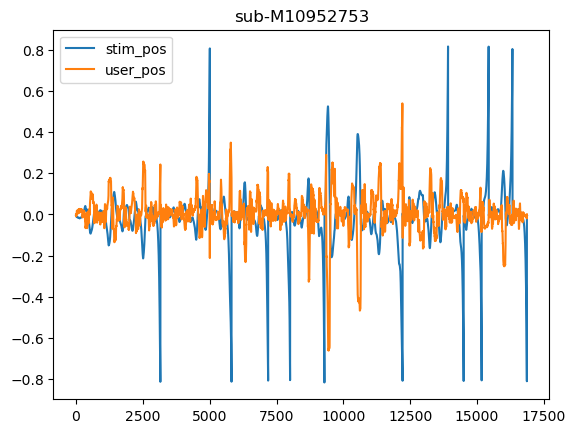

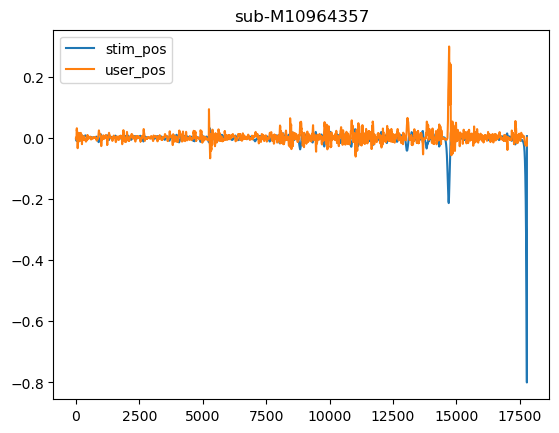

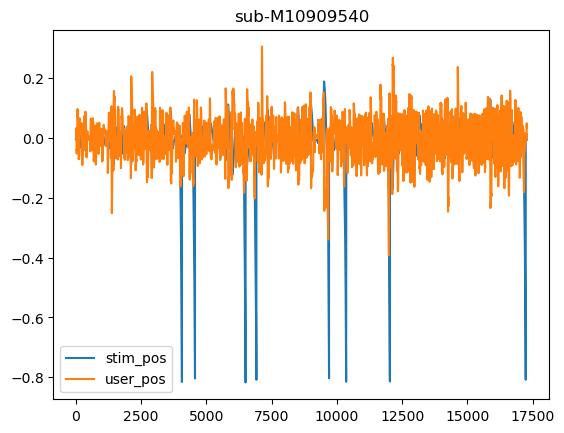

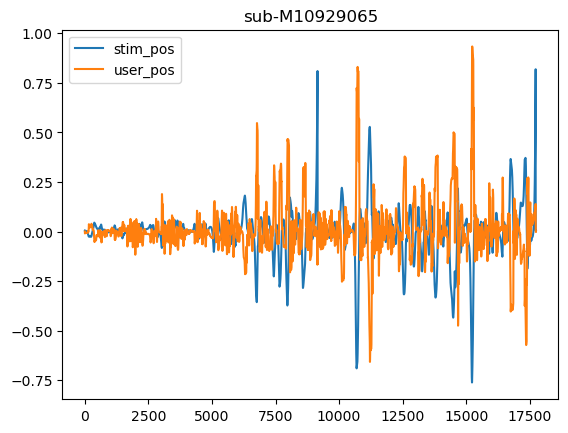

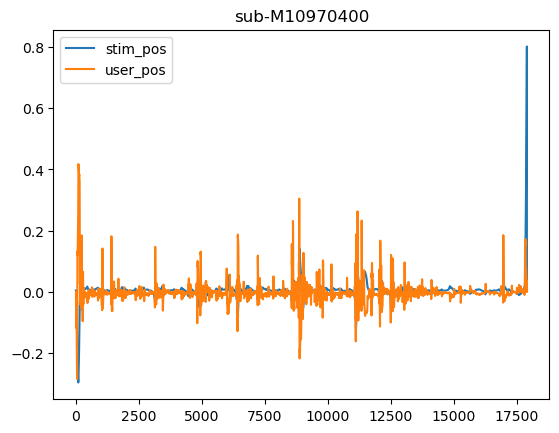

In [35]:
for file in missing_data_dict['proc_cpCST'].values():
    df = pd.read_csv(file)
    plt.plot(df.stim_pos, label='stim_pos')
    plt.plot(df.user_pos, label='user_pos')
    plt.title(file.split('/')[-1].split('_')[0])
    
    plt.legend()
    plt.show()


# Reprocessing

In [2]:
from reproc_cpCST import *

M10952753


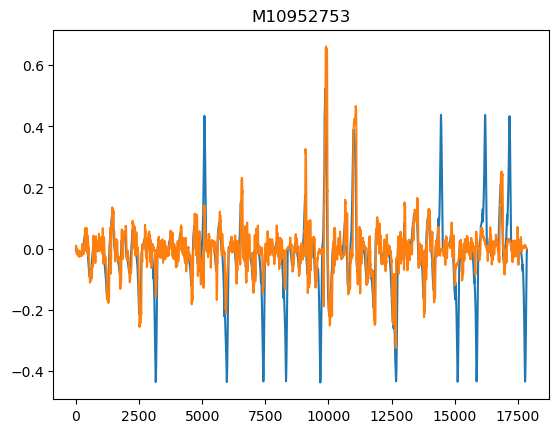

M10964357


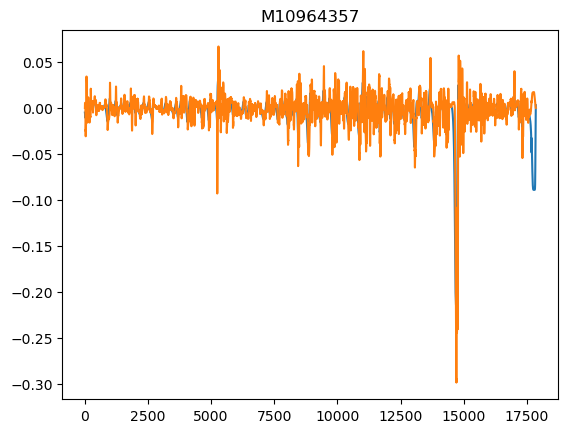

M10909540


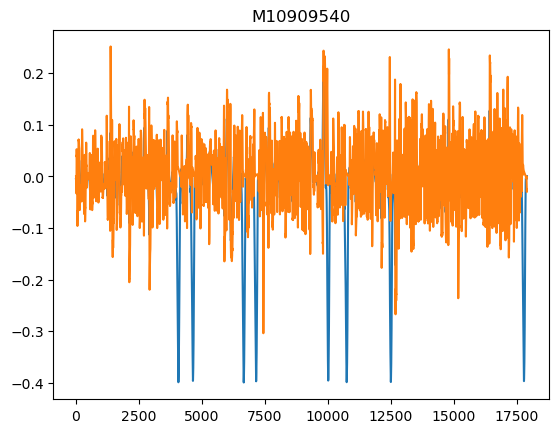

M10929065


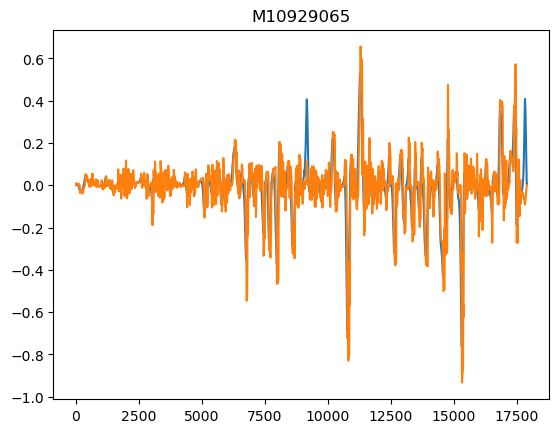

M10970400


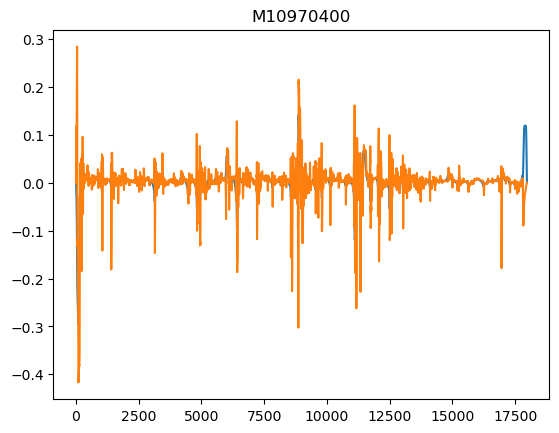

In [ ]:
data_need_proc = '/Users/danielgarcia-barnett/Desktop/Coding/cpCST_data_analysis/IRT_extraction/test_data/feb_1_2025/test_4/problem_data'

raw_data = {}
for file in os.listdir(data_need_proc):
    ptp = file.split('/')[-1].split('_')[0].split('-')[1]
    file_path = os.path.join(data_need_proc, file)
    
    df = pd.read_csv(file_path)

    # try:
    raw_data[ptp] = df
    ursi = get_ursi(str(file_path))
    print(ursi)

    df.user_pos = df.user_pos * -1
    cr = CrashRepair(df)
    cr.set_target_max_position() # Set the reset value for crash repair based 
                                # on the user's data distribution.
    repaired_df = cr.repair_tracking()
    df = repaired_df

    plt.plot(df.stim_pos, label='stim_pos')
    plt.plot(df.user_pos, label='user_pos')
    plt.title(ursi)
    plt.show()


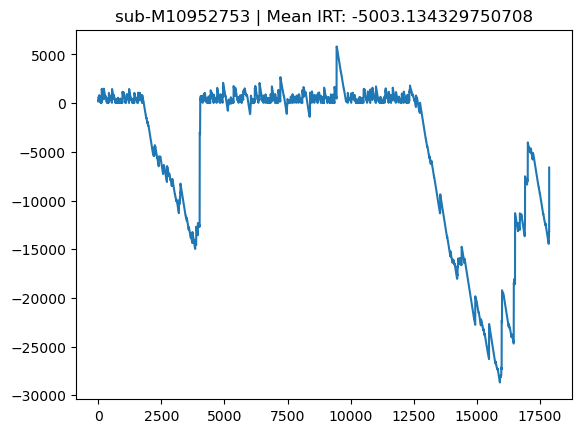

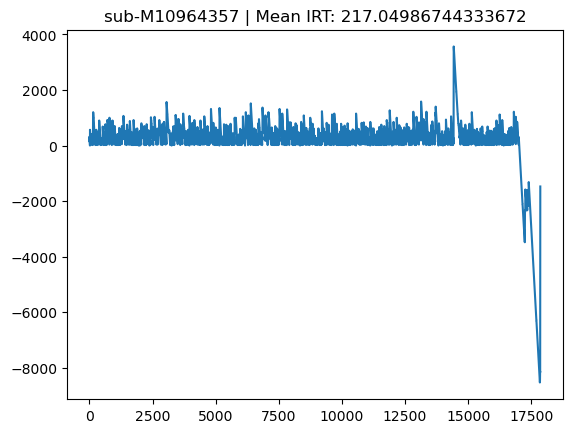

UnicodeDecodeError: 'utf-8' codec can't decode byte 0x80 in position 3131: invalid start byte

In [16]:
new_irt_data = '/Users/danielgarcia-barnett/Desktop/Coding/cpCST_data_analysis/IRT_extraction/test_data/feb_1_2025/test_4/irt_data'
for file in os.listdir(new_irt_data):
    df = pd.read_csv(os.path.join(new_irt_data, file))
    df.irt = df.irt * 1000  # convert to ms
    plt.plot(df.irt)
    plt.title(f'{file.split('/')[-1].split('_')[0]} | Mean IRT: {np.mean(df.irt)}')
    plt.show()


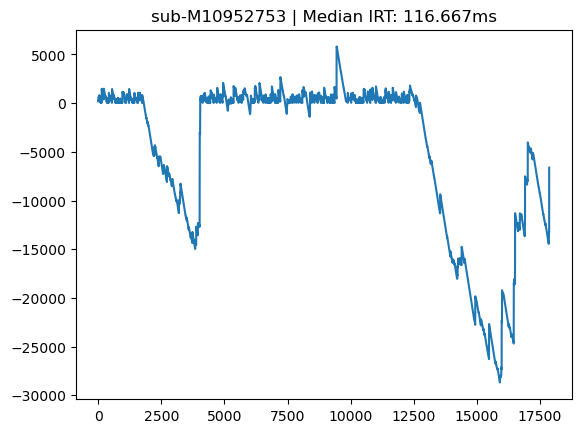

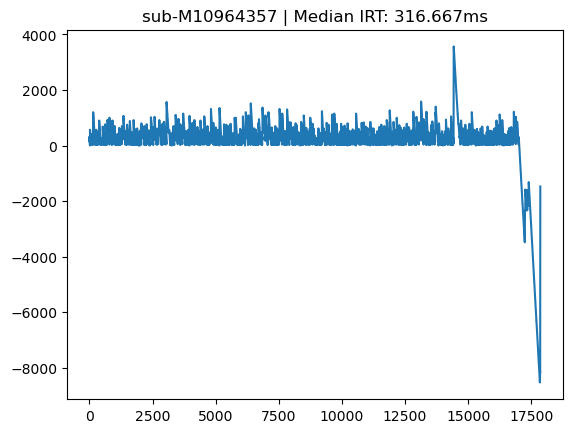

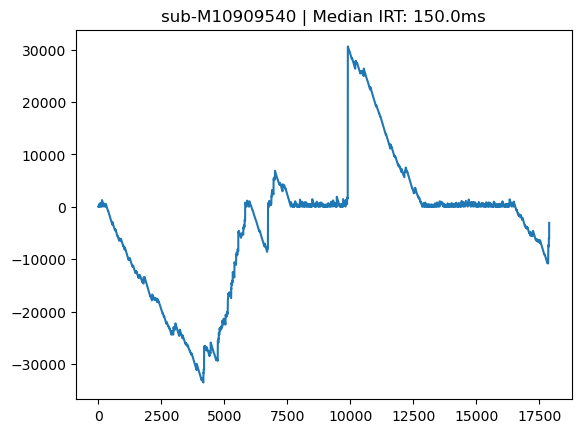

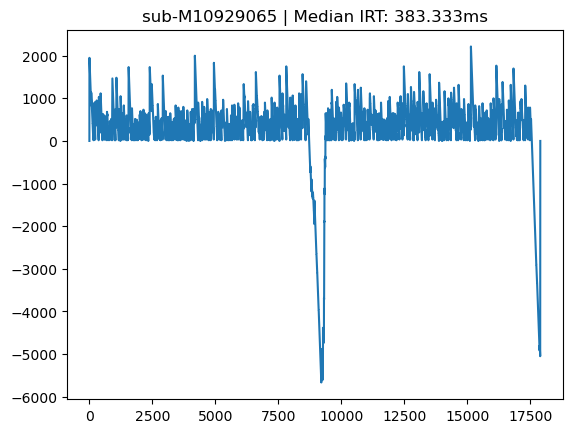

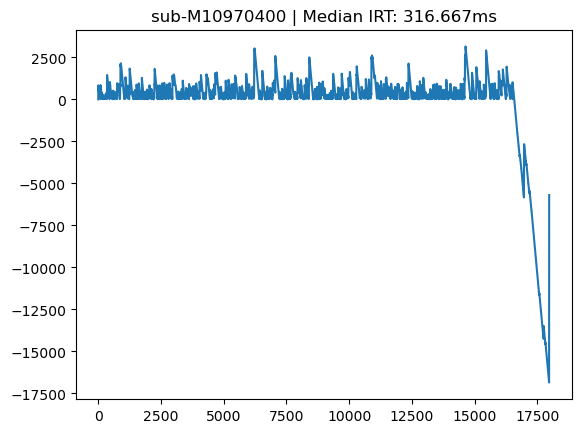

In [15]:
new_irt_data = '/Users/danielgarcia-barnett/Desktop/Coding/cpCST_data_analysis/IRT_extraction/test_data/feb_1_2025/test_4/irt_data'
for file in os.listdir(new_irt_data):
    df = pd.read_csv(os.path.join(new_irt_data, file))
    df.irt = df.irt * 1000  # convert to ms
    plt.plot(df.irt)
    plt.title(f'{file.split('/')[-1].split('_')[0]} | Median IRT: {np.round(np.median(df.irt), 3)}ms')
    plt.show()


In [43]:
aberrant_ptps = []

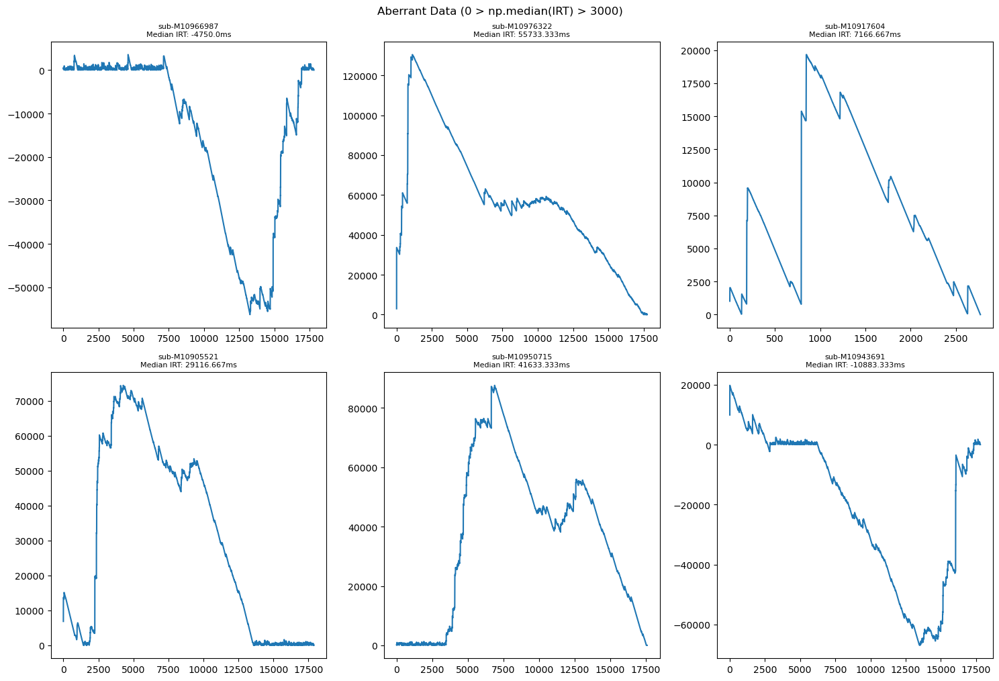

In [44]:
irt_data = "/Users/danielgarcia-barnett/Desktop/Coding/cpCST_data_analysis/IRT_extraction/test_data/feb_1_2025/test_3/proc_irt_feb_1_2025_drop"
files = os.listdir(irt_data)

valid_files = []  

for file in files:
    df = pd.read_csv(os.path.join(irt_data, file))
    df.irt = df.irt * 1000  # Convert to ms
    median_irt = np.median(df.irt)
    
    if (median_irt > 3000 or median_irt < 0):
        valid_files.append((file, df))  

n_cols = 3
n_rows = int(np.ceil(len(valid_files) / n_cols))

fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 5, n_rows * 5))

for i, (file, df) in enumerate(valid_files):
    row, col = divmod(i, n_cols)
    ax = axes[row, col] if n_rows > 1 else axes[col]  # Handle single-row case

    ax.plot(df.irt)
    ptp = file.split('/')[-1].split('_')[0]
    aberrant_ptps.append(ptp)
    ax.set_title(f"{ptp}\nMedian IRT: {np.round(np.median(df.irt), 3)}ms", fontsize=8)

for i in range(len(valid_files), n_rows * n_cols):  # Remove unused subplots
    row, col = divmod(i, n_cols)
    fig.delaxes(axes[row, col] if n_rows > 1 else axes[col])

plt.tight_layout()
plt.suptitle('Aberrant Data (0 > np.median(IRT) > 3000)', y=1.01)
plt.show()

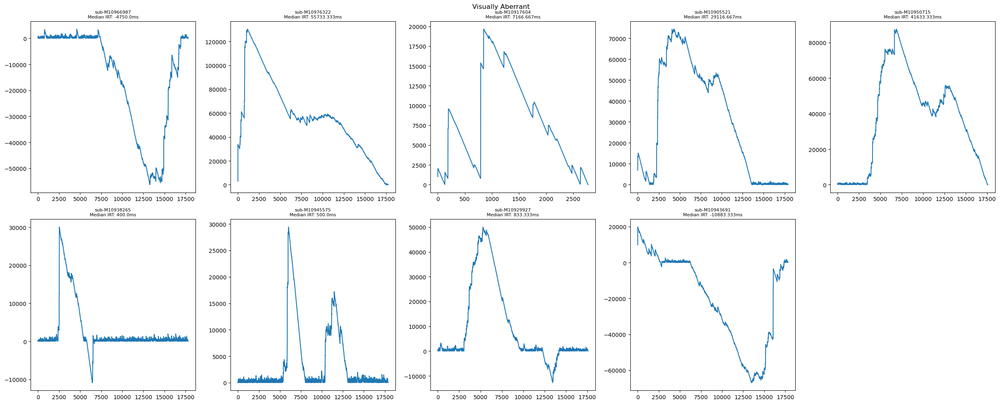

In [46]:
valid_files = []

for file in files:
    df = pd.read_csv(os.path.join(irt_data, file))
    df.irt = df.irt * 1000  # Convert to ms
    if np.abs(df.irt).max() > 15000 and ((np.median(df.irt) > 3000 or np.median(df.irt) < 0) or np.mean(df.irt) > 2000):
        valid_files.append((file, df))

n_cols = 5
n_rows = int(np.ceil(len(valid_files) / n_cols))

fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 5, n_rows * 5))

for i, (file, df) in enumerate(valid_files):
    row, col = divmod(i, n_cols)
    ax = axes[row, col] if n_rows > 1 else axes[col]  # Handle single-row case

    ax.plot(df.irt)
    ptp = file.split('/')[-1].split('_')[0]
    aberrant_ptps.append(ptp)
    ax.set_title(f"{ptp}\nMedian IRT: {np.round(np.median(df.irt), 3)}ms", fontsize=8)

for i in range(len(valid_files), n_rows * n_cols):  # Remove unused subplots
    row, col = divmod(i, n_cols)
    fig.delaxes(axes[row, col] if n_rows > 1 else axes[col])

plt.tight_layout()
plt.suptitle('Visually Aberrant', y=1.001)
plt.show()

In [38]:
irt_data = "/Users/danielgarcia-barnett/Desktop/Coding/cpCST_data_analysis/IRT_extraction/test_data/feb_1_2025/test_3/proc_irt_feb_1_2025_drop"
files = os.listdir(irt_data)

valid_files = []  

for file in files:
    df = pd.read_csv(os.path.join(irt_data, file))
    df.irt = df.irt * 1000  # Convert to ms
    median_irt = np.median(df.irt)
    
    if not (median_irt > 3000 or median_irt < 0):
        valid_files.append((file, df))  

n_cols = 10
n_rows = int(np.ceil(len(valid_files) / n_cols))

fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 5, n_rows * 5))

for i, (file, df) in enumerate(valid_files):
    row, col = divmod(i, n_cols)
    ax = axes[row, col] if n_rows > 1 else axes[col]  # Handle single-row case

    ax.plot(df.irt)
    ax.set_title(f"{file.split('/')[-1].split('_')[0]}\nMedian IRT: {np.round(np.median(df.irt), 3)}ms", fontsize=8)

for i in range(len(valid_files), n_rows * n_cols):  # Remove unused subplots
    row, col = divmod(i, n_cols)
    fig.delaxes(axes[row, col] if n_rows > 1 else axes[col])

plt.tight_layout()
plt.suptitle('Aberrant Data (0 > np.median(IRT) > 3000)', y=1.001)
plt.show()

In [21]:
irt_data = "/Users/danielgarcia-barnett/Desktop/Coding/cpCST_data_analysis/IRT_extraction/test_data/feb_1_2025/test_3/proc_irt_feb_1_2025_drop"
files = os.listdir(irt_data)

n_cols = 15
n_rows = int(np.ceil(len(files) / n_cols))

fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 5, n_rows * 5))

for i, file in enumerate(files):
    df = pd.read_csv(os.path.join(irt_data, file))
    df.irt = df.irt * 1000  # convert to ms

    row, col = divmod(i, n_cols)
    ax = axes[row, col] if n_rows > 1 else axes[col]  # Handle 1-row case
    
    ax.plot(df.irt)
    ax.set_title(f"{file.split('/')[-1].split('_')[0]}\nMedian IRT: {np.round(np.median(df.irt), 3)}ms", fontsize=8)

for i in range(len(files), n_rows * n_cols):  # Hide unused subplots
    row, col = divmod(i, n_cols)
    fig.delaxes(axes[row, col] if n_rows > 1 else axes[col])

plt.tight_layout()
plt.show()

# Test 1

In [137]:
irt_data = '/Users/danielgarcia-barnett/Desktop/Coding/cpCST_data_analysis/IRT_extraction/test_data/feb_1_2025/test_1/irt_data'
irt_dict = {}
for file in os.listdir(irt_data):
    ptp = file.split('_')[0]
    irt_df = pd.read_csv(os.path.join(irt_data, file))
    irt_df.irt = irt_df.irt * 1000
    irt_dict[ptp] = irt_df


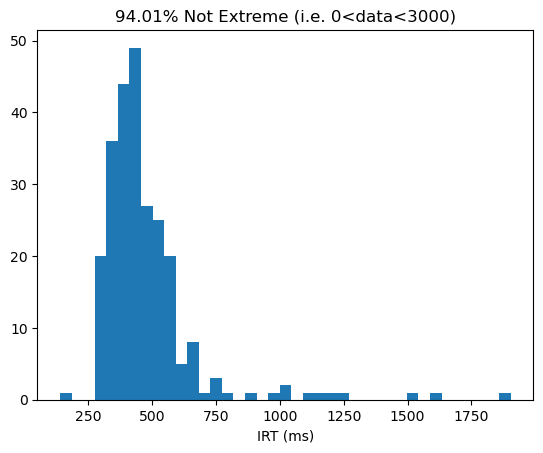

In [138]:
non_extreme_irt_means = [np.mean(df.irt) for df in irt_dict.values() if np.mean(df.irt) > 0 and np.mean(df.irt) < 3000]
plt.hist(non_extreme_irt_means, bins='auto')
plt.title(f'{np.round(len(non_extreme_irt_means)*100/len(irt_dict), 2)}% Not Extreme (i.e. 0<data<3000)')
plt.xlabel('IRT (ms)')
plt.show()

In [139]:
extreme_dtw = {ptp:df for ptp, df in irt_dict.items() if np.mean(df.irt) < 0 or np.mean(df.irt) > 3000}
len(extreme_dtw)

16

In [14]:
raw_cpCST_path = '/Users/danielgarcia-barnett/Desktop/Coding/cpCST_data_analysis/IRT_extraction/test_data/feb_1_2025/cpCST_data'
raw_cpcst_dict = {}
for file in os.listdir(raw_cpCST_path):
    if file.endswith('.csv'):
        ptp = file.split('_')[0]
        try:
            cpcst_df = pd.read_csv(os.path.join(raw_cpCST_path, file))
            raw_cpcst_dict[ptp] = cpcst_df
        except Exception as e:
            print(f"Error processing {file}: {e}")

proc_cpCST_path = '/Users/danielgarcia-barnett/Desktop/Coding/cpCST_data_analysis/IRT_extraction/test_data/feb_1_2025/proc_cpCST_data'
proc_cpcst_dict = {}
for file in os.listdir(proc_cpCST_path):
    if file.endswith('.csv'):
        ptp = file.split('_')[0]
        try:
            cpcst_df = pd.read_csv(os.path.join(proc_cpCST_path, file))
            proc_cpcst_dict[ptp] = cpcst_df
        except Exception as e:
            print(f"Error processing {file}: {e}")


In [53]:
def get_crashes(data):
    crashes = [(idx, stim_pos) for idx, stim_pos in enumerate(data) if np.abs(stim_pos) > 0.7]
    diff_array = np.diff([idx[0] for idx in crashes])
    switch_idx = [0]+[idx+1 for idx, val in enumerate(diff_array) if val > 1]
    crash_list = []
    for i, idx in enumerate(switch_idx):
        try:
            crash_list.append(max(crashes[idx:switch_idx[i+1]], key=lambda x: abs(x[1])))
        except:
            crash_list.append(max(crashes[idx:-1], key=lambda x: abs(x[1])))

    return crash_list

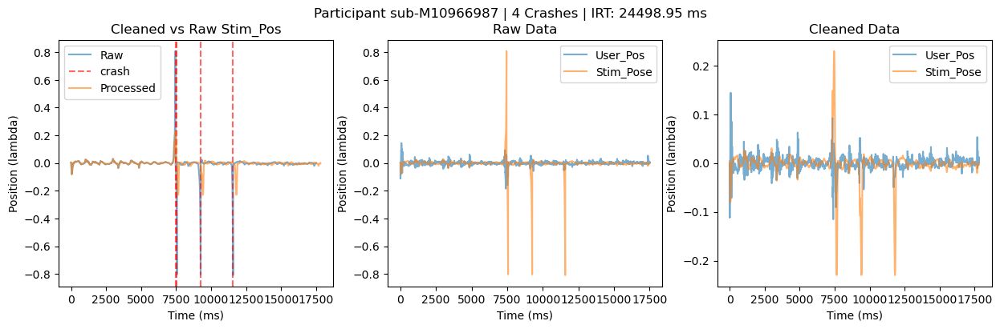

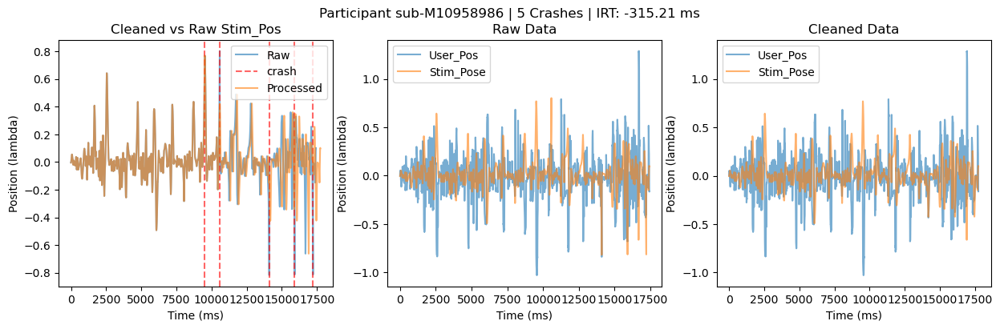

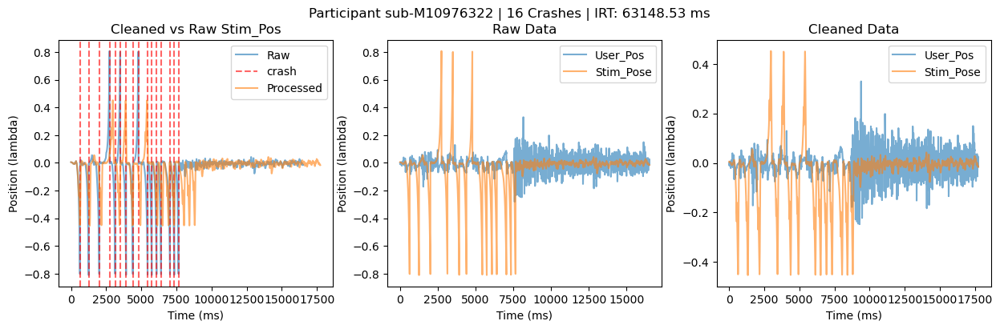

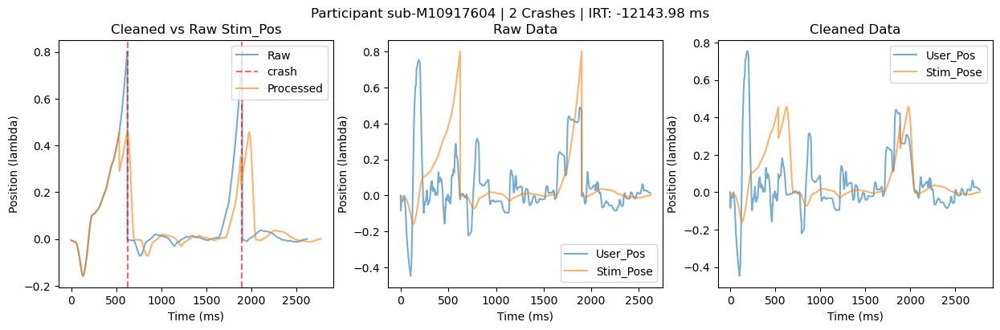

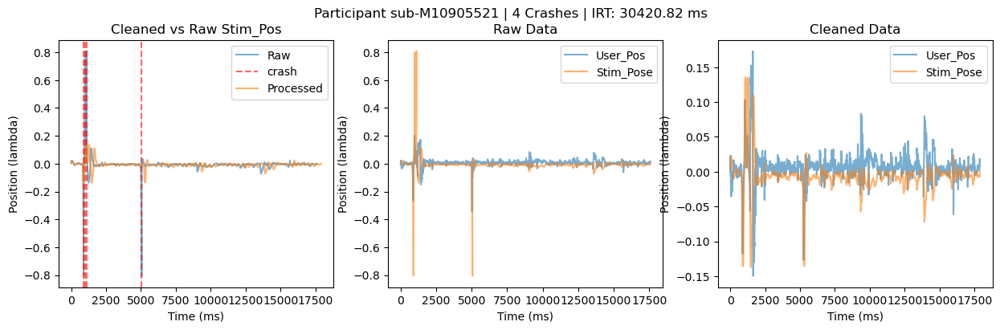

...

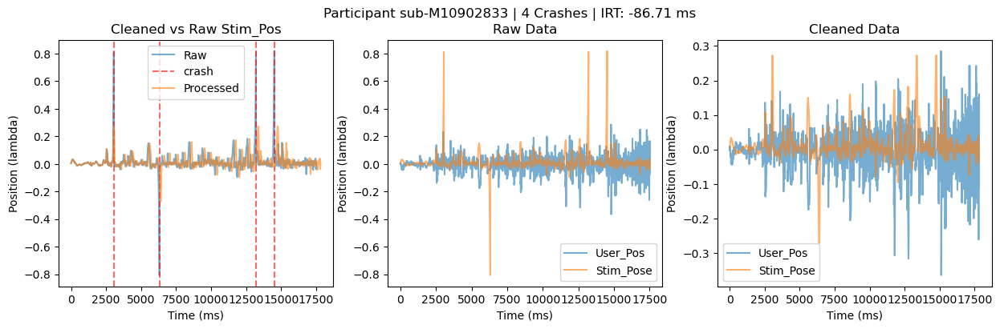

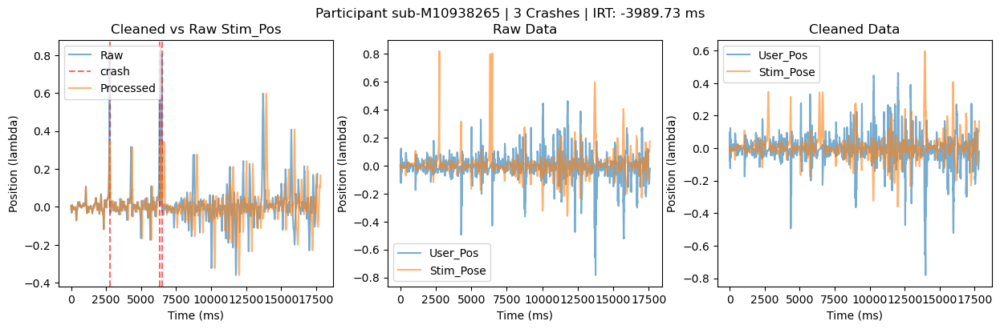

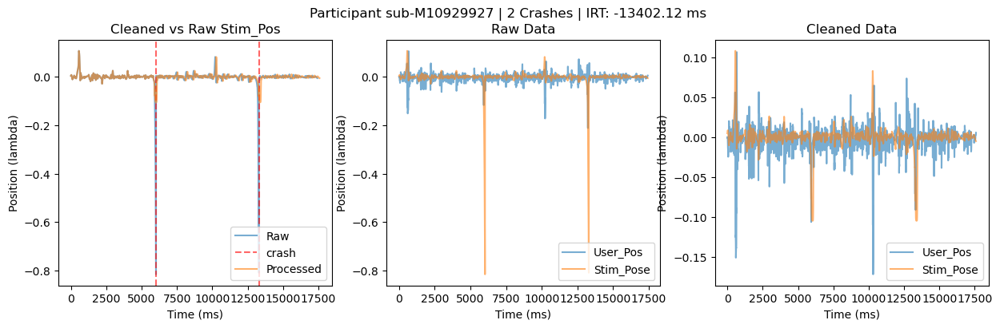

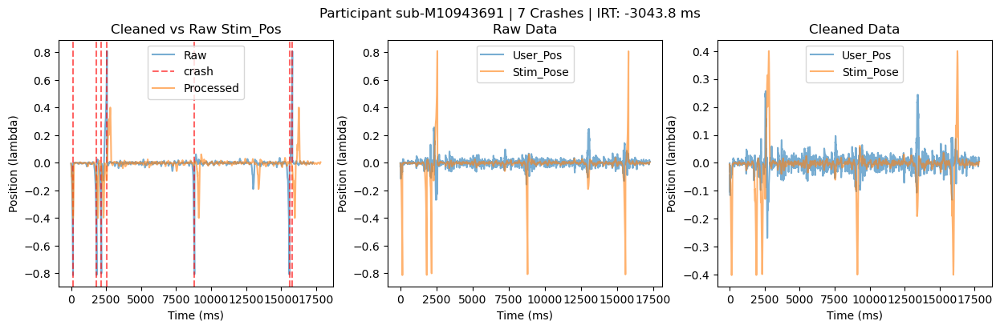

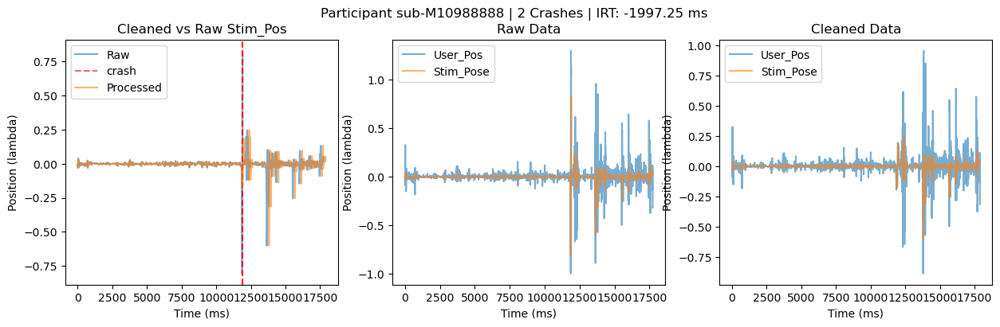

In [124]:
def plot_crashes(ptp_num):
    fig, axes = plt.subplots(1, 3, figsize=(15, 4))
    axes.flatten()

    axes[0].plot(raw_cpcst_dict[ptp_num].stim_pos, label='Raw', alpha=0.6)
    crashes = get_crashes(raw_cpcst_dict[ptp_num].stim_pos)
    for i, crash in enumerate(crashes):
        if i == 0:
            axes[0].axvline(x=crash[0], linestyle='--', color='red', alpha=0.6, label='crash')
        else:
            axes[0].axvline(x=crash[0], linestyle='--', color='red', alpha=0.6)

    axes[0].plot(proc_cpcst_dict[ptp_num].stim_pos, label='Processed', alpha=0.6)
    axes[0].set_xlabel('Time (ms)')
    axes[0].set_ylabel('Position (lambda)')
    axes[0].set_title('Cleaned vs Raw Stim_Pos')
    axes[0].legend()

    axes[1].plot(raw_cpcst_dict[ptp_num].user_pos, label='User_Pos', alpha=0.6)
    axes[1].plot(raw_cpcst_dict[ptp_num].stim_pos, label='Stim_Pose', alpha=0.6)
    axes[1].set_xlabel('Time (ms)')
    axes[1].set_ylabel('Position (lambda)')
    axes[1].set_title('Raw Data')
    axes[1].legend()

    axes[2].plot(proc_cpcst_dict[ptp_num].user_pos, label='User_Pos', alpha=0.6)
    axes[2].plot(proc_cpcst_dict[ptp_num].stim_pos, label='Stim_Pose', alpha=0.6)
    axes[2].set_xlabel('Time (ms)')
    axes[2].set_ylabel('Position (lambda)')
    axes[2].set_title('Cleaned Data')
    axes[2].legend()

    plt.suptitle(f'Participant {ptp_num} | {len(crashes)} Crashes | IRT: {np.round(extreme_dtw[ptp_num], 2)} ms')
    plt.show()

for ptp in extreme_dtw.keys():
    plot_crashes(ptp)

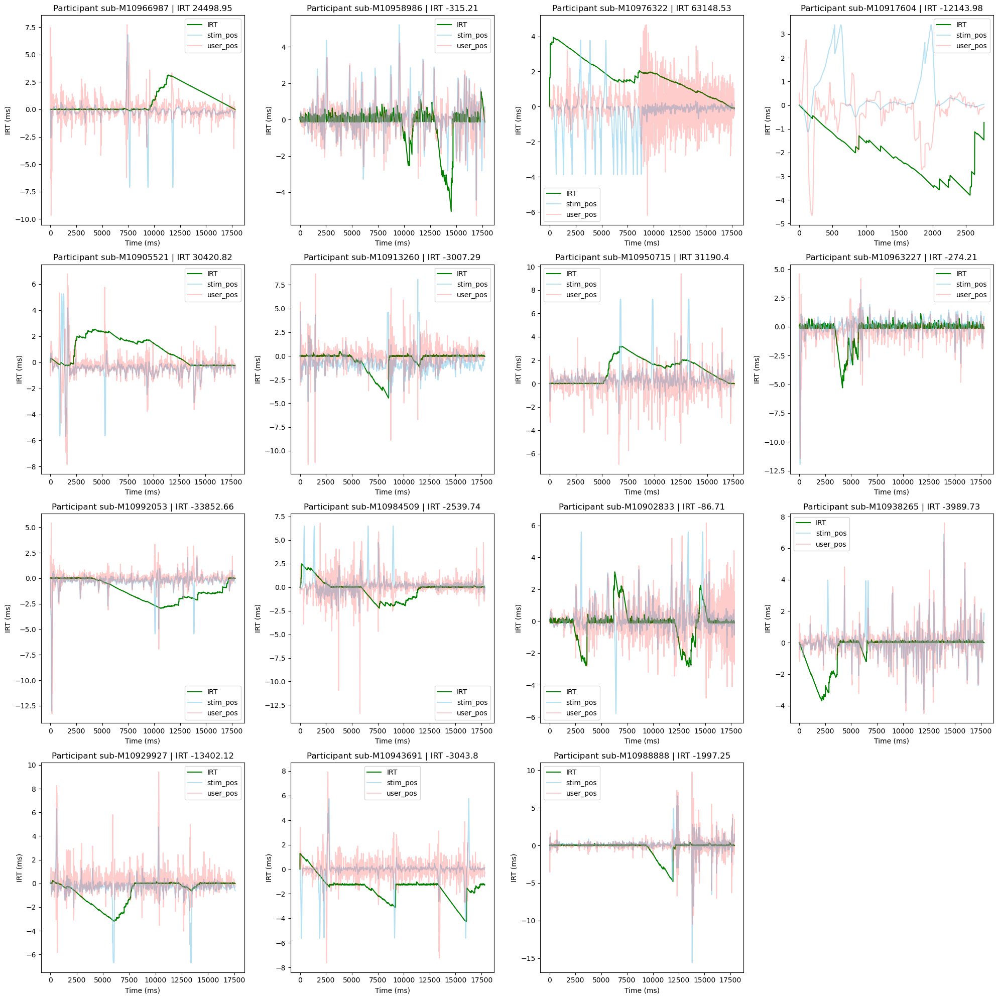

In [ ]:
# Calculate number of subplots needed
num_participants = len(extreme_dtw)
num_cols = 4
num_rows = (num_participants + num_cols - 1) // num_cols  # This ensures we round up when dividing

# Create a figure with the calculated number of rows and columns
fig, axs = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(20, num_rows * 5))

# Flatten the axs array for easy iteration
axs = axs.flatten()

# Loop through participants and plot each one in a subplot
for idx, ptp in enumerate(extreme_dtw.keys()):
    irt_df = irt_dict[ptp]
    ax = axs[idx]  # Access the specific subplot (ax)
    
    # Plotting the data on the specific subplot
    ax.plot(zscore(irt_df.irt) - zscore(irt_df.irt)[0], color='green', label='IRT')
    ax.plot(zscore(irt_df.stim_pos) - zscore(irt_df.stim_pos)[0], color='skyblue', label='stim_pos', alpha=0.6)
    ax.plot(zscore(irt_df.user_pos) - zscore(irt_df.user_pos)[0], color='red', label='user_pos', alpha=0.2)
    
    ax.set_title(f'Participant {ptp} | IRT {np.round(np.mean(irt_df.irt), 2)}')
    ax.set_xlabel('Time (ms)')
    ax.set_ylabel('IRT (ms)')
    ax.legend()

# Hide any unused subplots if the number of participants doesn't fill the grid
for idx in range(num_participants, len(axs)):
    axs[idx].axis('off')

plt.tight_layout()  # Adjusts layout to avoid overlap
plt.show()

# Test 2

In [110]:
irt_data = '/Users/danielgarcia-barnett/Desktop/Coding/cpCST_data_analysis/IRT_extraction/test_data/feb_1_2025/test_2/IRT_data'
irt_dict = {}
for file in os.listdir(irt_data):
    ptp = file.split('_')[0]
    irt_df = pd.read_csv(os.path.join(irt_data, file))
    irt_df.irt = irt_df.irt * 1000
    irt_dict[ptp] = irt_df


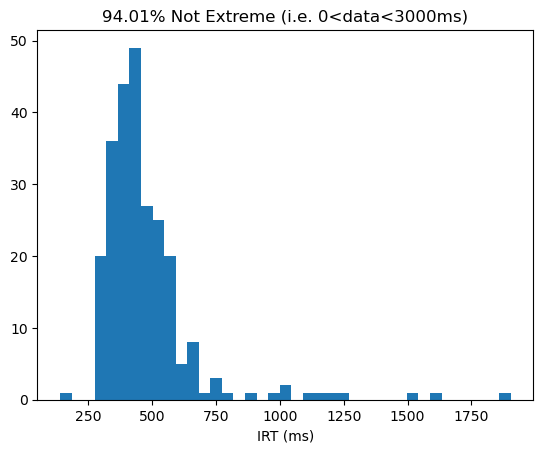

In [116]:
non_extreme_irt_means = [np.mean(df.irt) for df in irt_dict.values() if np.mean(df.irt) > 0 and np.mean(df.irt) < 3000]
plt.hist(non_extreme_irt_means, bins='auto')
plt.title(f'{np.round(len(non_extreme_irt_means)*100/len(irt_dict), 2)}% Not Extreme (i.e. 0<data<3000ms)')
plt.xlabel('IRT (ms)')
plt.show()

In [102]:
raw_cpCST_path = '/Users/danielgarcia-barnett/Desktop/Coding/cpCST_data_analysis/IRT_extraction/test_data/feb_1_2025/raw_cpCST_data'
raw_cpcst_dict = {}
for file in os.listdir(raw_cpCST_path):
    if file.endswith('.csv'):
        ptp = file.split('_')[0]
        try:
            cpcst_df = pd.read_csv(os.path.join(raw_cpCST_path, file))
            raw_cpcst_dict[ptp] = cpcst_df
        except Exception as e:
            print(f"Error processing {file}: {e}")

proc_cpCST_path = '/Users/danielgarcia-barnett/Desktop/Coding/cpCST_data_analysis/IRT_extraction/test_data/feb_1_2025/test_2/proc_cpCST_data'
proc_cpcst_dict = {}
for file in os.listdir(proc_cpCST_path):
    if file.endswith('.csv'):
        ptp = file.split('_')[0]
        try:
            cpcst_df = pd.read_csv(os.path.join(proc_cpCST_path, file))
            proc_cpcst_dict[ptp] = cpcst_df
        except Exception as e:
            print(f"Error processing {file}: {e}")


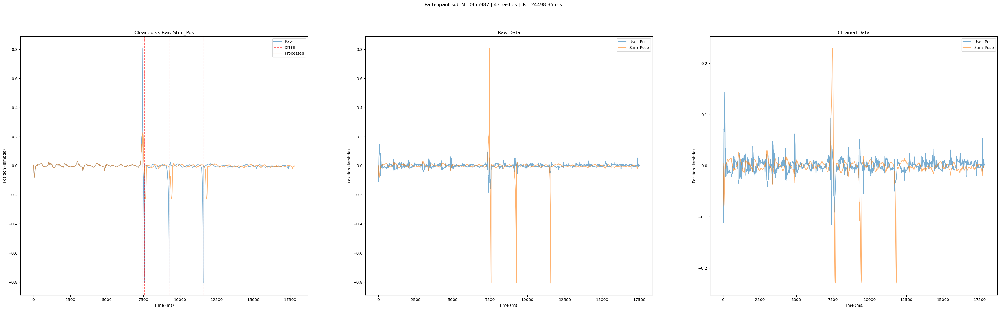

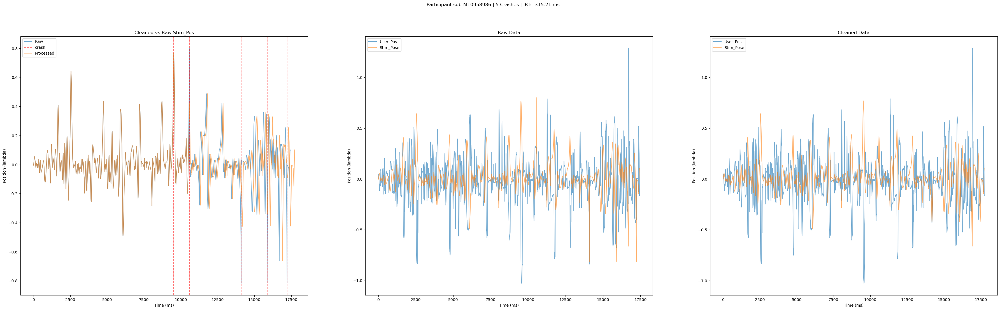

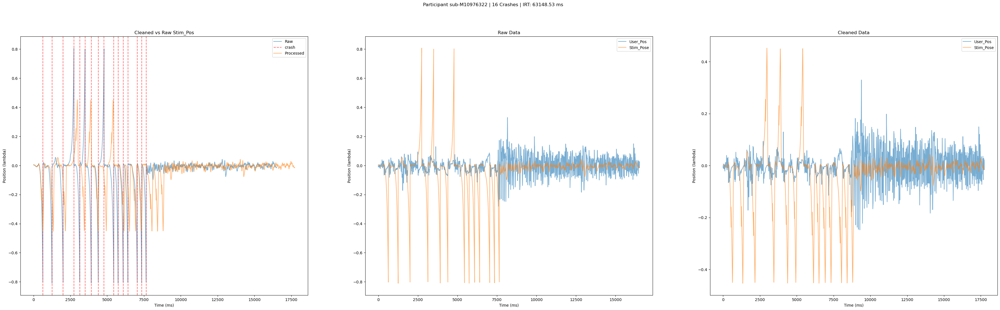

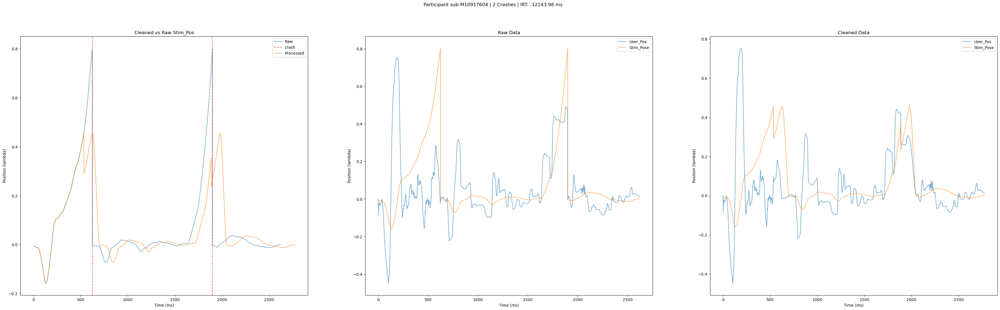

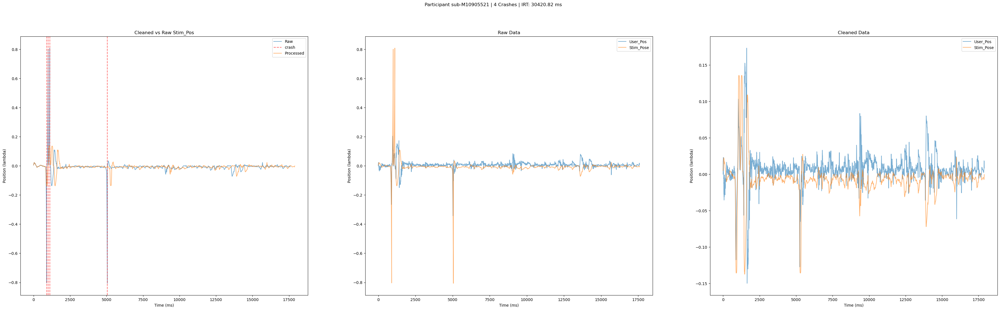

...

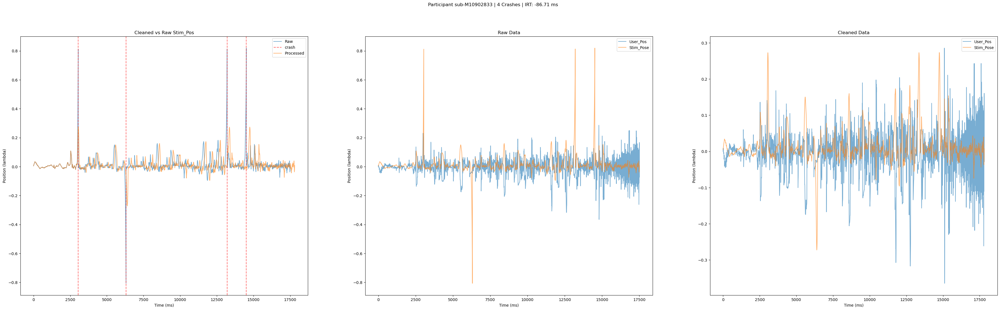

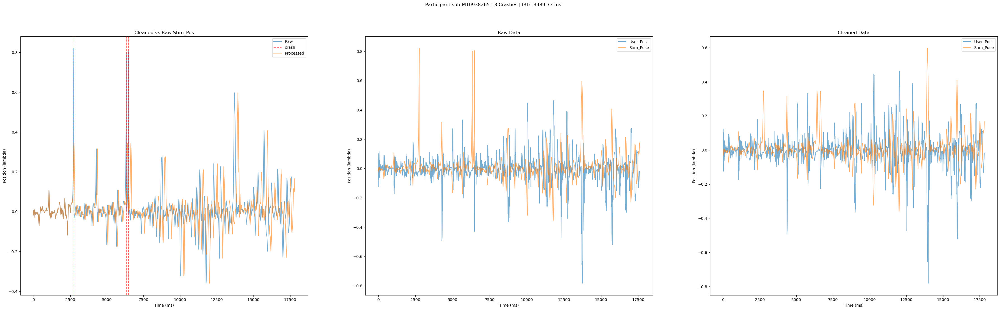

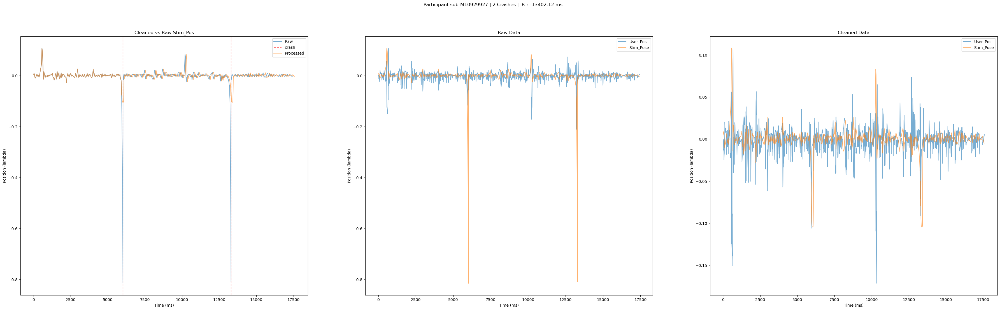

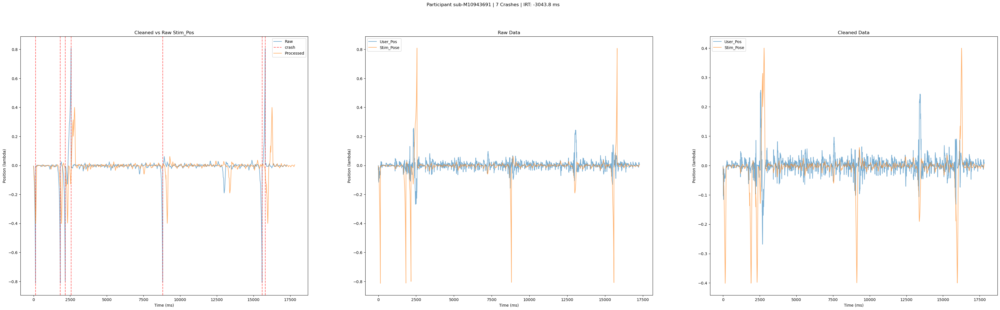

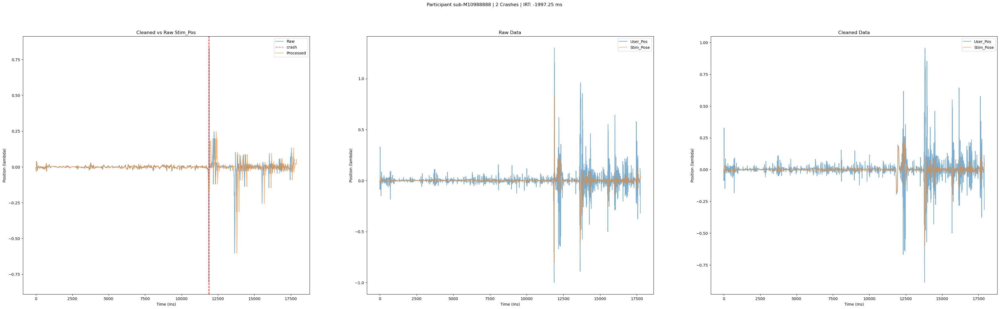

In [105]:
for ptp in extreme_dtw.keys():
    plot_crashes(ptp)

# Test 3

In [158]:
import shutil

In [160]:
irt_path = '/Users/danielgarcia-barnett/Desktop/Coding/cpCST_data_analysis/IRT_extraction/test_data/feb_1_2025/test_3/irt_data'
irt_drop = '/Users/danielgarcia-barnett/Desktop/Coding/cpCST_data_analysis/IRT_extraction/test_data/feb_1_2025/test_3/proc_irt_feb_1_2024_drop'
irt_dict = {}
for file in os.listdir(irt_path):
    ptp = file.split('_')[0]
    fpath = os.path.join(irt_path, file)
    irt_df = pd.read_csv(fpath)
    irt_df.irt = irt_df.irt * 1000
    if np.mean(irt_df.irt) > 0 and np.mean(irt_df.irt) < 3000:
        shutil.move(fpath, irt_drop)


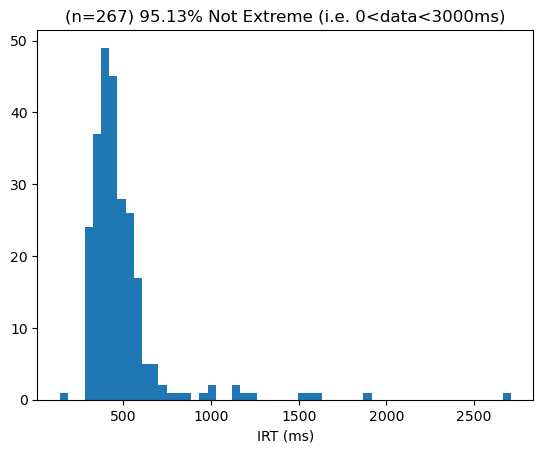

In [153]:
non_extreme_irt_means = [np.mean(df.irt) for df in irt_dict.values() if np.mean(df.irt) > 0 and np.mean(df.irt) < 3000]
plt.hist(non_extreme_irt_means, bins='auto')
plt.title(f'(n={len(irt_dict)}) {np.round(len(non_extreme_irt_means)*100/len(irt_dict), 2)}% Not Extreme (i.e. 0<data<3000ms)')
plt.xlabel('IRT (ms)')
plt.show()

In [154]:
extreme_dtw = {ptp:df for ptp, df in irt_dict.items() if np.mean(df.irt) < 0 or np.mean(df.irt) > 3000}
len(extreme_dtw)

13

In [155]:
uwu1 = extreme_dtw.keys()

In [156]:
fixed = []
for ptp in uwu2:
    if ptp not in uwu1:
        fixed.append(ptp)

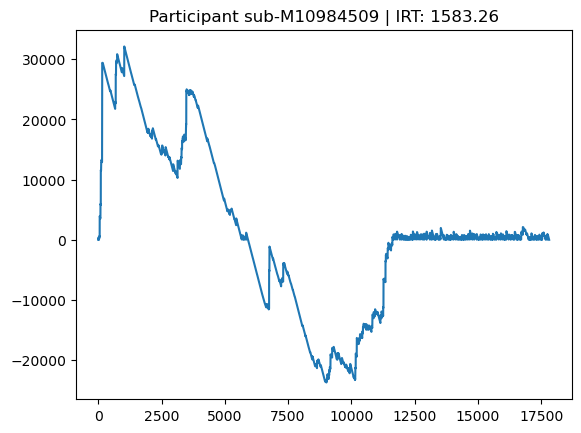

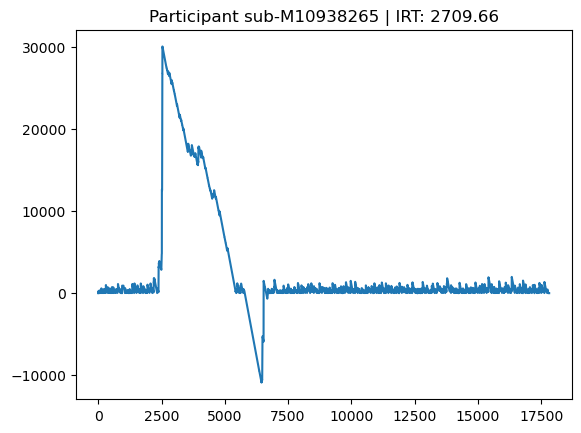

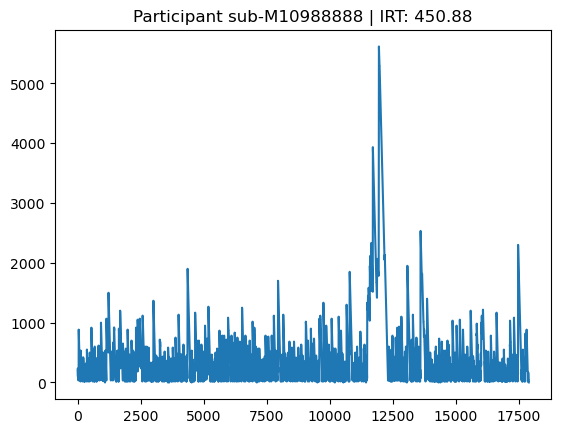

In [157]:
for ptp in fixed:
    plt.plot(irt_dict[ptp].irt)
    plt.title(f'Participant {ptp} | IRT: {np.round(np.mean(irt_dict[ptp].irt), 2)}')
    plt.show()

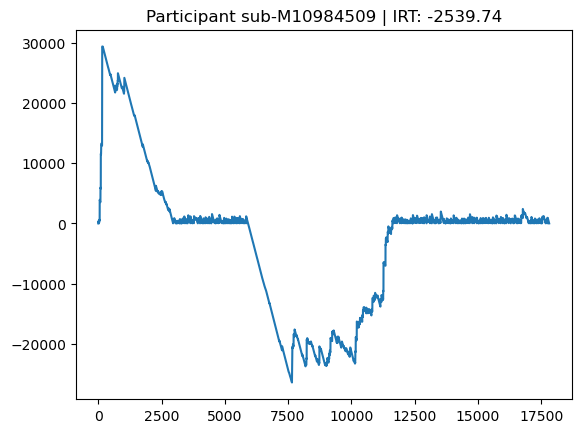

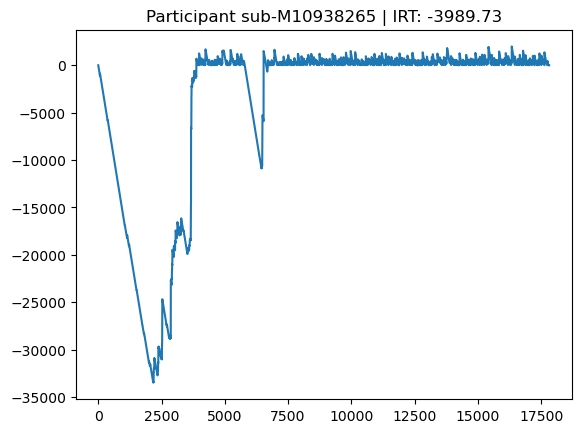

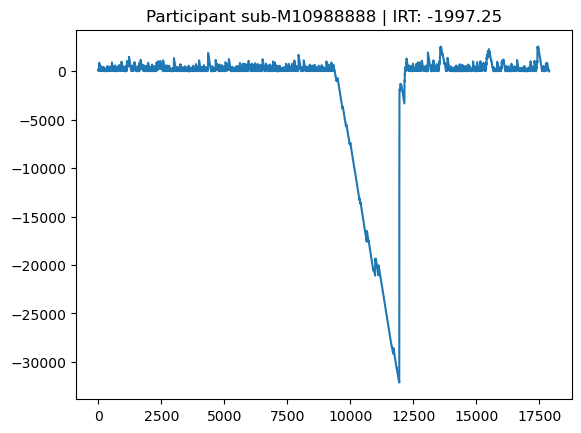

In [151]:
for ptp in fixed:
    plt.plot(irt_dict[ptp].irt)
    plt.title(f'Participant {ptp} | IRT: {np.round(np.mean(irt_dict[ptp].irt), 2)}')
    plt.show()